In [ ]:
# Mount Google Drive

from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


In [ ]:
import os
from tqdm import tqdm
import time
import copy
import gc

import torchvision
from torchvision import datasets, models, transforms

from PIL import Image

import pickle

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
import numpy as np

from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay


import matplotlib.pyplot as plt

cudnn.benchmark = True

### Funções auxiliares

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

def visualize_model(model, dataloaders, class_names, device, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]}, label: {class_names[labels[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
    ])
    
    class_names = [1, 2, 3]
    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        dataset_sizes = {x: 0 for x in ['train', 'val']}
        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
                batch_files = [f'train_{x+1}' for x in range(6)]
            else:
                model.eval()   # Set model to evaluate mode
                batch_files = [f'val_{x+1}' for x in range(2)]

            running_loss = 0.0
            running_corrects = 0

            # Set the dataloaders for each batch
            for batch_file in batch_files:
              # Carrega as imagens pré-processadas de cada dataset
              with open(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/batch data/leave out test/{batch_file}.pkl', 'rb') as f:
                  data = pickle.load(f)

              # Normalização e conversão em tensores
              data = [(transform(img), label) for img, label in data]

              if phase == 'train':
                image_datasets = {'train': data, 'val': []}
                dataloaders = {'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=4,
                                                          shuffle=True, num_workers=4),
                               'val': []}
              else:
                image_datasets = {'train': [], 'val': data}
                dataloaders = {'train': [],
                               'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=4,
                                                          shuffle=True, num_workers=4)}
              

              dataset_sizes = {x: dataset_sizes[x]+len(image_datasets[x]) for x in ['train', 'val']}

              # Iterate over data.
              for inputs, labels in tqdm(dataloaders[phase]):
                  inputs = inputs.to(device)
                  labels = labels.to(device)

                  # zero the parameter gradients
                  optimizer.zero_grad()

                  # forward
                  # track history if only in train
                  with torch.set_grad_enabled(phase == 'train'):
                      outputs = model(inputs)
                      _, preds = torch.max(outputs, 1)
                      loss = criterion(outputs, labels)

                      # backward + optimize only if in training phase
                      if phase == 'train':
                          loss.backward()
                          optimizer.step()

                  # statistics
                  running_loss += loss.item() * inputs.size(0)
                  running_corrects += torch.sum(preds == labels.data)
              if phase == 'train':
                  scheduler.step()

              epoch_loss = running_loss / dataset_sizes[phase]
              epoch_acc = running_corrects.double() / dataset_sizes[phase]

              print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f} ({running_corrects.double()}/{dataset_sizes[phase]}) \n')

              # deep copy the model
              if phase == 'val' and epoch_acc > best_acc:
                  best_acc = epoch_acc
                  best_model_wts = copy.deepcopy(model.state_dict())
              
              # Delete current partial dataset
              del data
              del image_datasets
              del dataloaders
              gc.collect()

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

### Função de teste

In [ ]:
def test_model(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152(pretrained=True)
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  model = models.vgg16_bn(pretrained=True)
  num_features = model.classifier[6].in_features
  features = list(model.classifier.children())[:-1] # Remove last layer
  features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  model.classifier = nn.Sequential(*features) # Replace the model classifier

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '_2058_224.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

### Teste com as imagens da escala Beaufort

In [ ]:
def test_img(img, model_name):
  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)

  ### VGG16
  model = models.vgg16_bn(pretrained=True)
  num_features = model.classifier[6].in_features
  features = list(model.classifier.children())[:-1] # Remove last layer
  features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  dataloaders = {'val': torch.utils.data.DataLoader([img], batch_size=1,
                                             shuffle=True, num_workers=4)}

  # Aplicação do teste
  model.eval()
  count = 0

  with torch.no_grad():
      for i, inputs in enumerate(dataloaders['val']):
          inputs = inputs.to(device)

          outputs = model(inputs)
          _, preds = torch.max(outputs, 1)

          return preds[0]

Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.


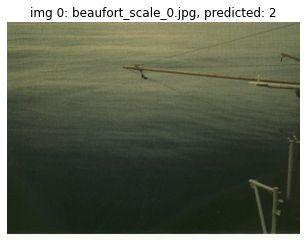

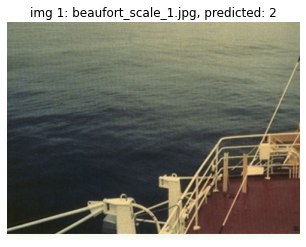

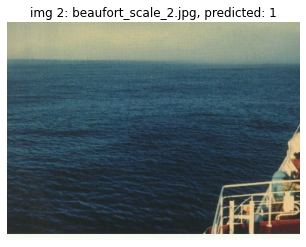

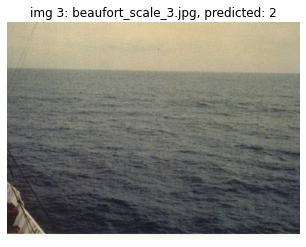

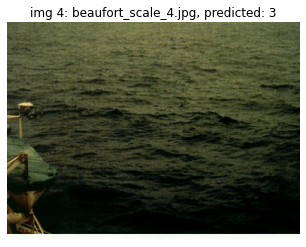

...

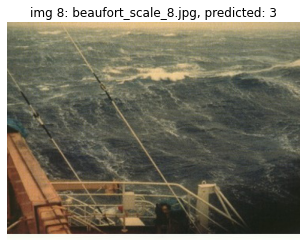

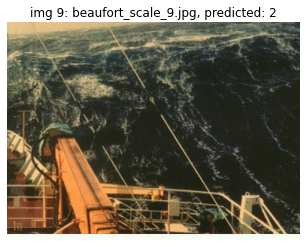

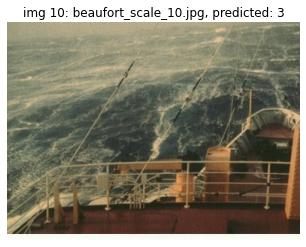

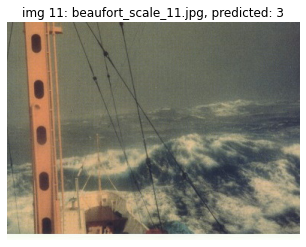

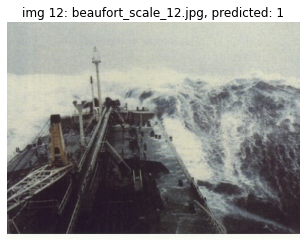

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  label = test_img(img_tensor, 'vgg16_splitted_untrained_tpn')

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[label]}')
  plt.imshow(img, cmap='gray')

### Teste com metrics

In [ ]:
def test_img(img, model_name):
  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  dataloaders = {'val': torch.utils.data.DataLoader([img], batch_size=1,
                                             shuffle=True, num_workers=4)}

  # Aplicação do teste
  model.eval()
  count = 0

  with torch.no_grad():
      for i, inputs in enumerate(dataloaders['val']):
          inputs = inputs.to(device)

          outputs = model(inputs)
          _, preds = torch.max(outputs, 1)

          return preds[0]

#### VGG16

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_tpn.


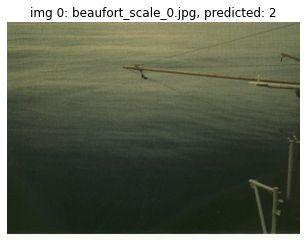

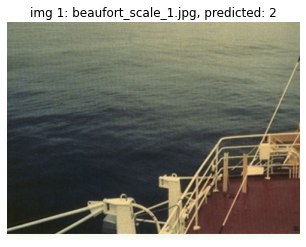

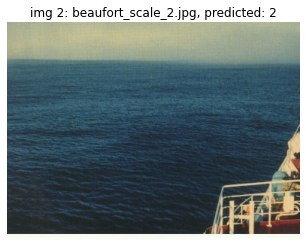

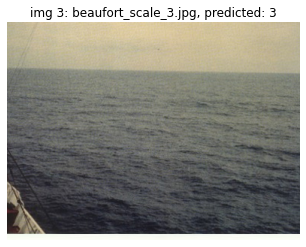

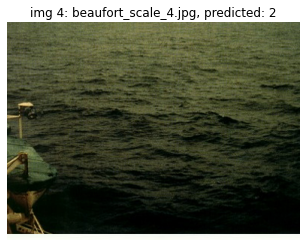

...

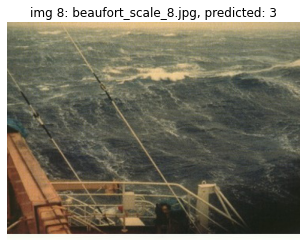

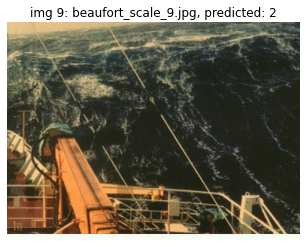

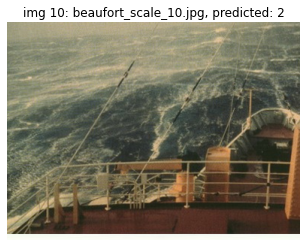

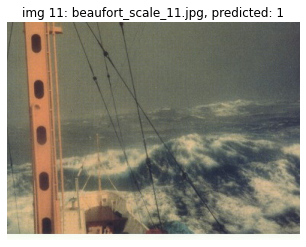

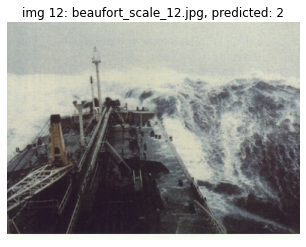

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.33333   0.75000   0.46154         4
           3    0.33333   0.20000   0.25000         5

    accuracy                        0.30769        13
   macro avg    0.22222   0.31667   0.23718        13
weighted avg    0.23077   0.30769   0.23817        13



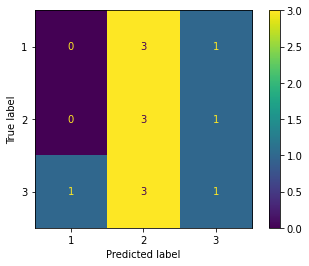

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_untrained_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_untrained_tpn.


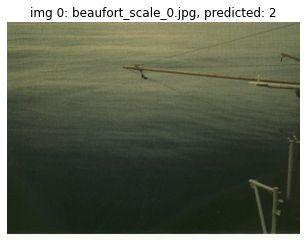

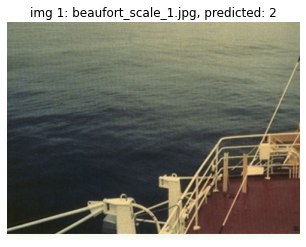

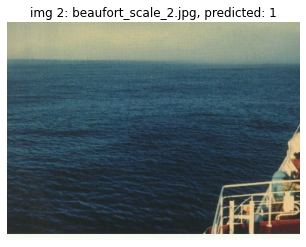

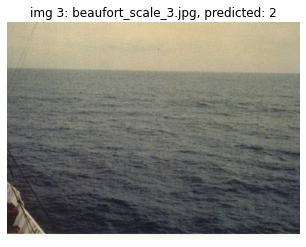

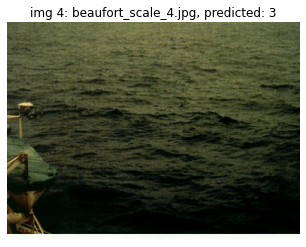

...

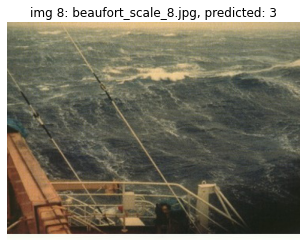

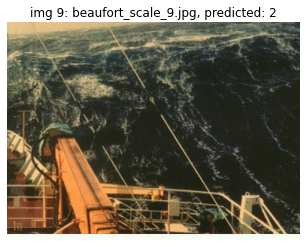

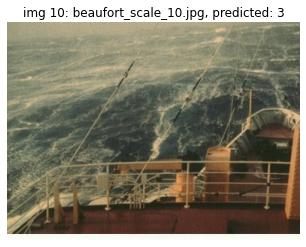

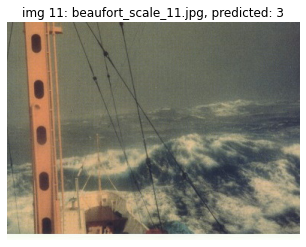

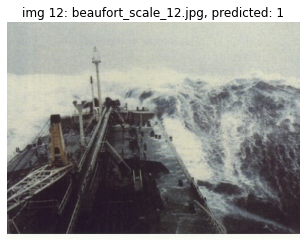

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_untrained_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.50000   0.25000   0.33333         4
           2    0.20000   0.25000   0.22222         4
           3    0.50000   0.60000   0.54545         5

    accuracy                        0.38462        13
   macro avg    0.40000   0.36667   0.36700        13
weighted avg    0.40769   0.38462   0.38073        13



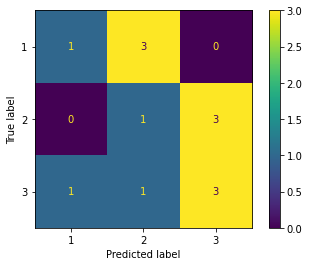

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_weighted_oversample_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_oversample_tpn.


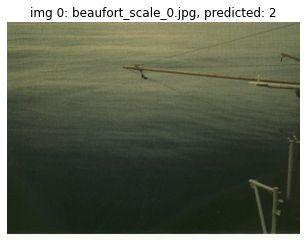

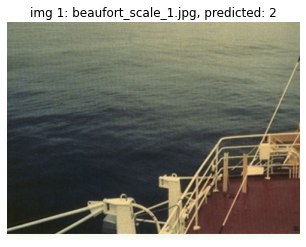

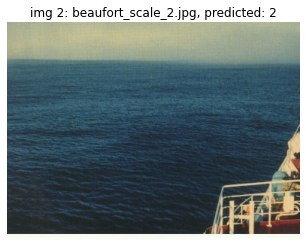

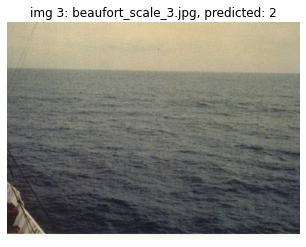

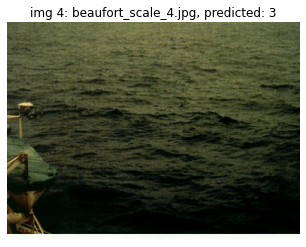

...

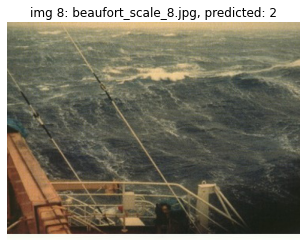

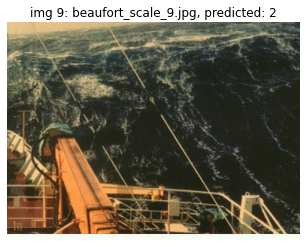

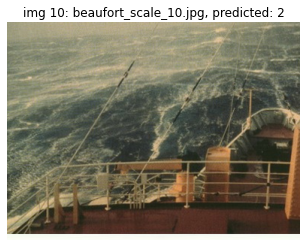

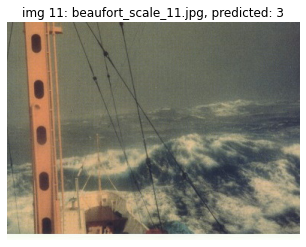

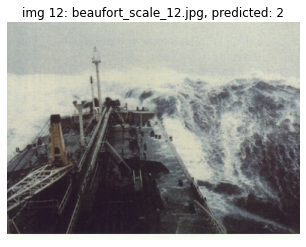

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_weighted_oversample_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.20000   0.50000   0.28571         4
           3    0.33333   0.20000   0.25000         5

    accuracy                        0.23077        13
   macro avg    0.17778   0.23333   0.17857        13
weighted avg    0.18974   0.23077   0.18407        13



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


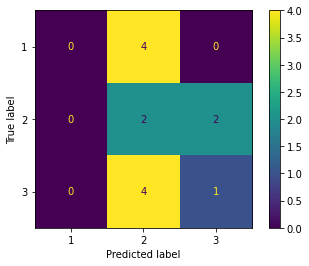

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model loaded from vgg16_splitted_weighted_loss_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_weighted_loss_tpn.


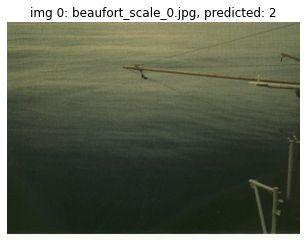

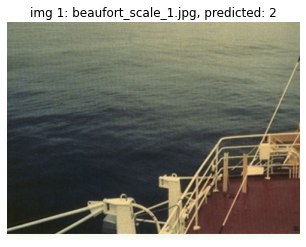

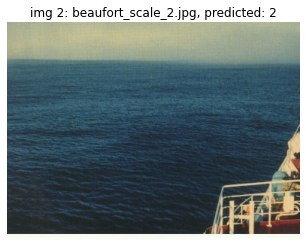

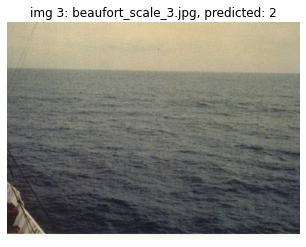

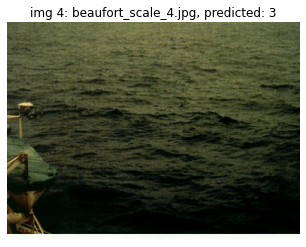

...

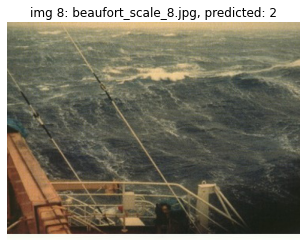

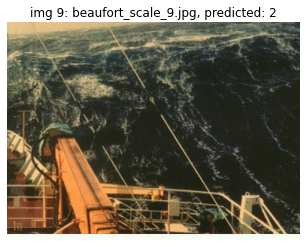

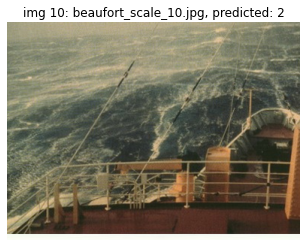

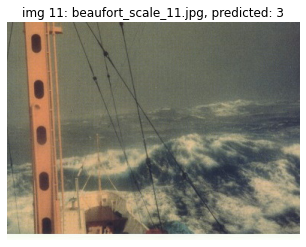

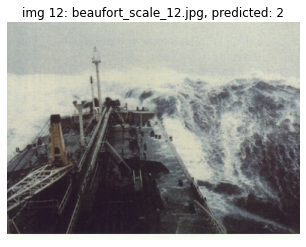

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_weighted_loss_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.11111   0.25000   0.15385         4
           3    0.25000   0.20000   0.22222         5

    accuracy                        0.15385        13
   macro avg    0.12037   0.15000   0.12536        13
weighted avg    0.13034   0.15385   0.13281        13



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


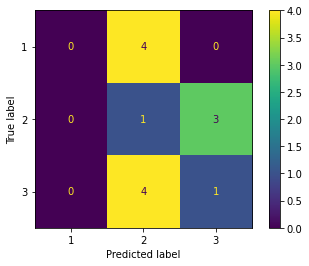

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cpu


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Model loaded from vgg16_splitted_untrained_v2_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.
Device: cpu
Model loaded from vgg16_splitted_untrained_v2_tpn.


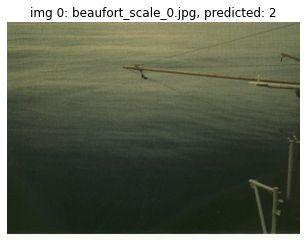

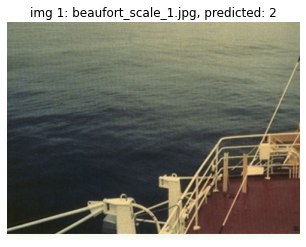

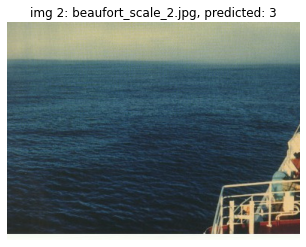

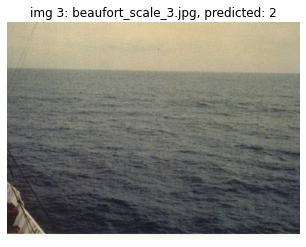

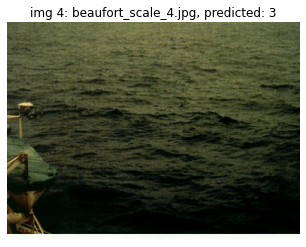

...

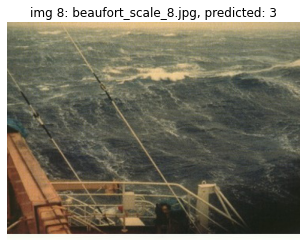

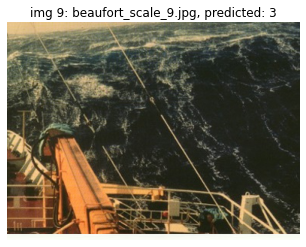

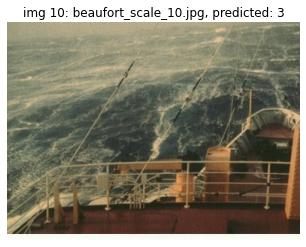

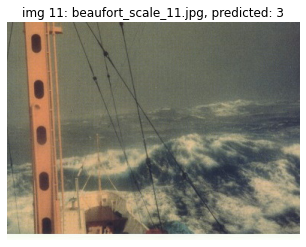

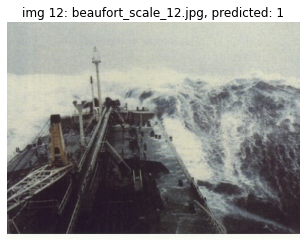

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_untrained_v2_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.00000   0.00000   0.00000         4
           3    0.44444   0.80000   0.57143         5

    accuracy                        0.30769        13
   macro avg    0.14815   0.26667   0.19048        13
weighted avg    0.17094   0.30769   0.21978        13



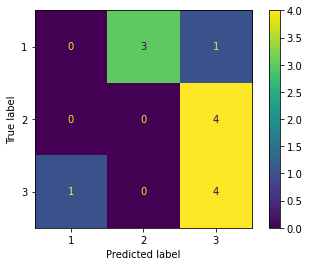

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34

Device: cuda:0
Model loaded from resnet34_splitted_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_tpn.


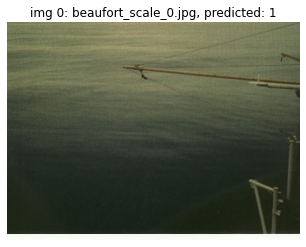

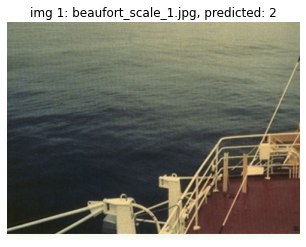

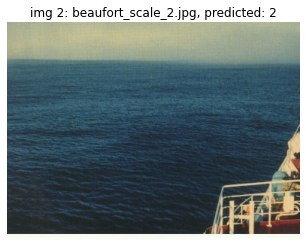

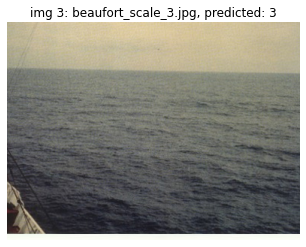

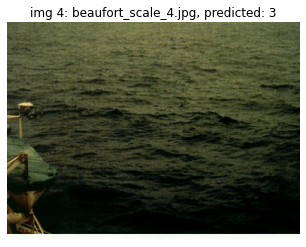

...

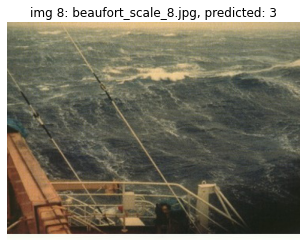

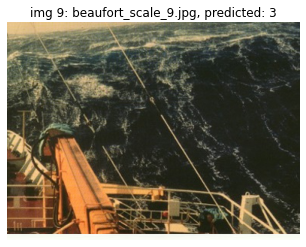

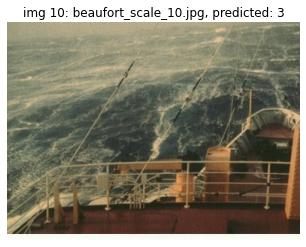

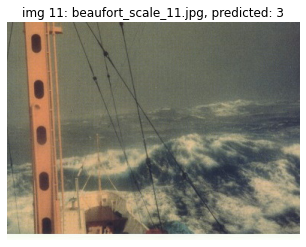

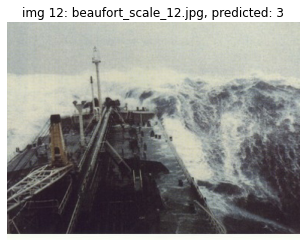

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_splitted_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.25000   0.40000         4
           2    0.33333   0.25000   0.28571         4
           3    0.55556   1.00000   0.71429         5

    accuracy                        0.53846        13
   macro avg    0.62963   0.50000   0.46667        13
weighted avg    0.62393   0.53846   0.48571        13



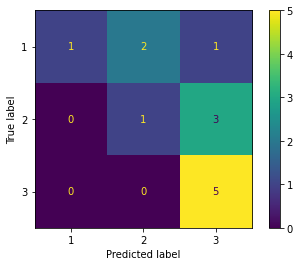

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_untrained_tpn.


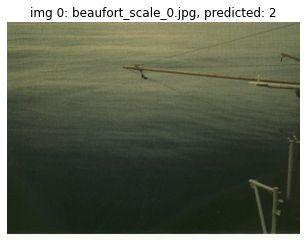

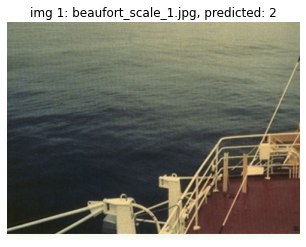

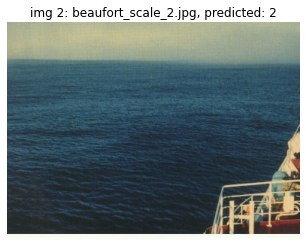

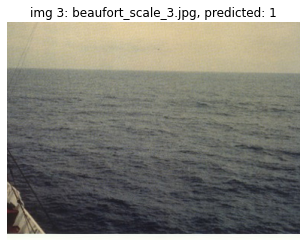

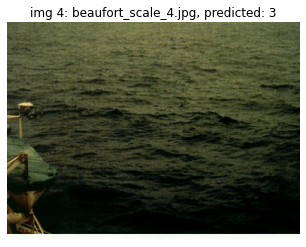

...

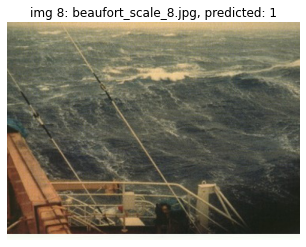

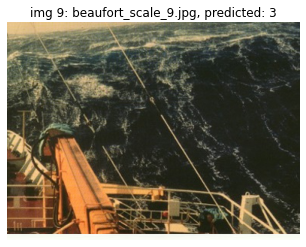

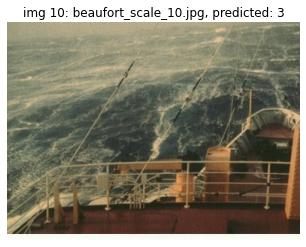

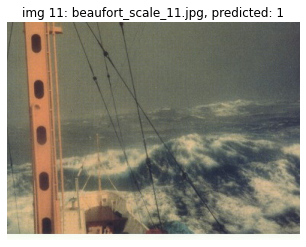

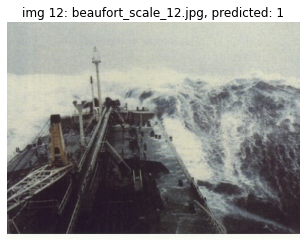

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_splitted_untrained_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.20000   0.25000   0.22222         4
           2    0.25000   0.25000   0.25000         4
           3    0.50000   0.40000   0.44444         5

    accuracy                        0.30769        13
   macro avg    0.31667   0.30000   0.30556        13
weighted avg    0.33077   0.30769   0.31624        13



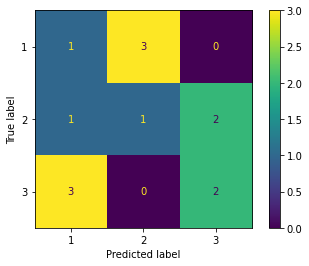

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


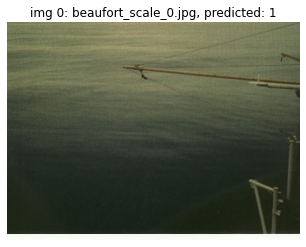

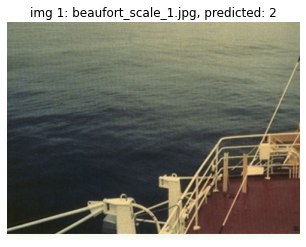

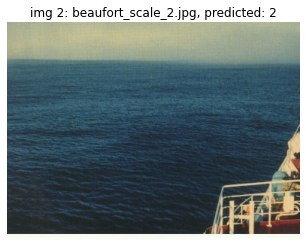

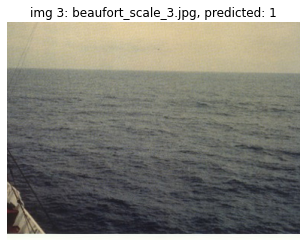

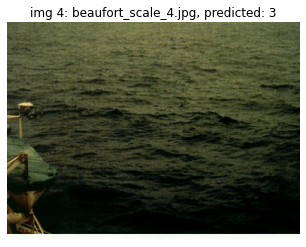

...

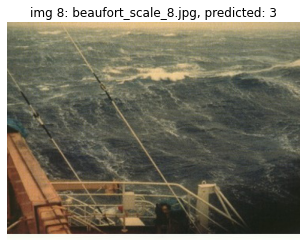

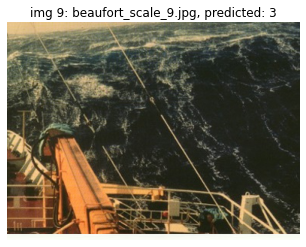

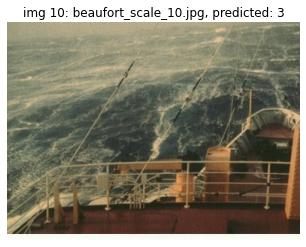

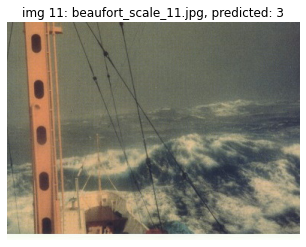

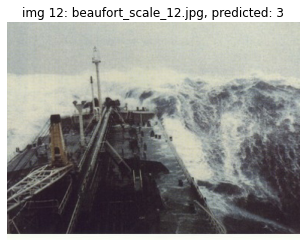

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_splitted_weighted_oversample_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.50000   0.66667         4
           2    0.33333   0.25000   0.28571         4
           3    0.62500   1.00000   0.76923         5

    accuracy                        0.61538        13
   macro avg    0.65278   0.58333   0.57387        13
weighted avg    0.65064   0.61538   0.58890        13



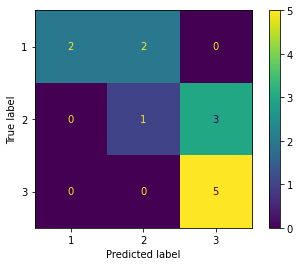

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_loss_tpn.


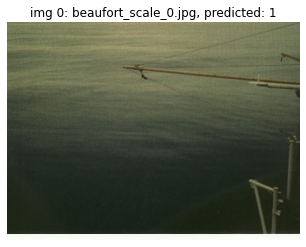

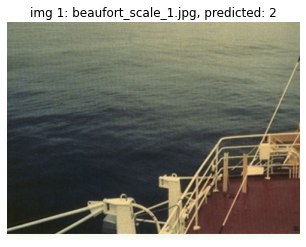

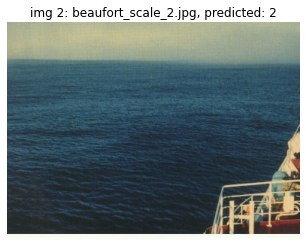

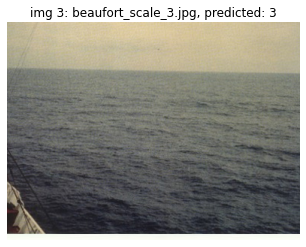

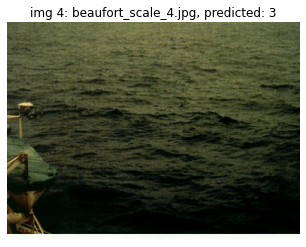

...

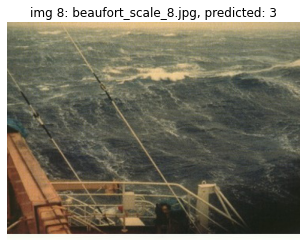

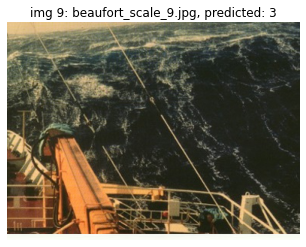

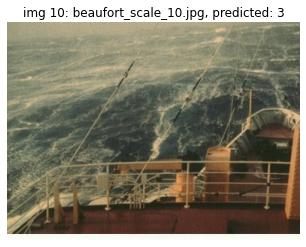

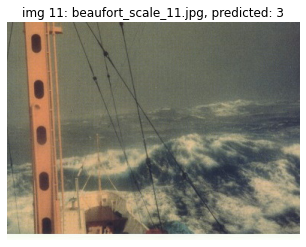

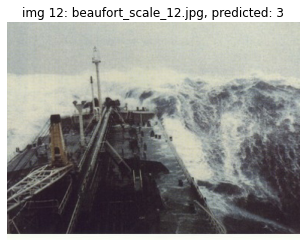

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_splitted_weighted_loss_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.25000   0.40000         4
           2    0.33333   0.25000   0.28571         4
           3    0.55556   1.00000   0.71429         5

    accuracy                        0.53846        13
   macro avg    0.62963   0.50000   0.46667        13
weighted avg    0.62393   0.53846   0.48571        13



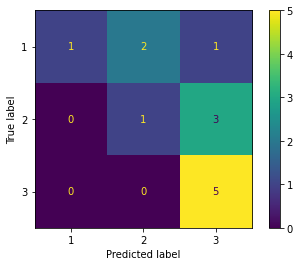

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet152

Device: cuda:0
Model loaded from resnet152_splitted_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_tpn.


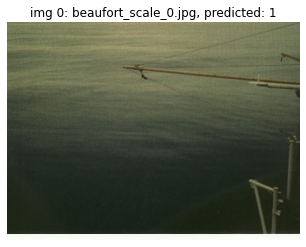

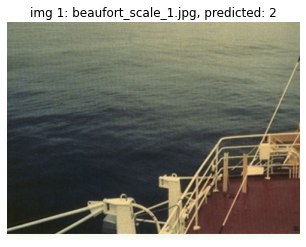

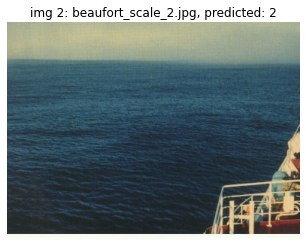

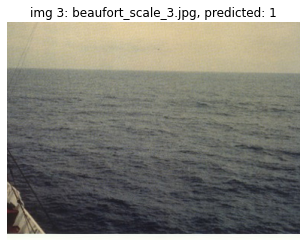

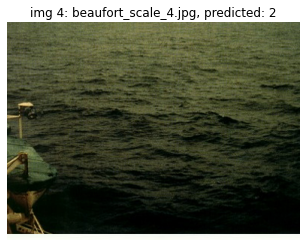

...

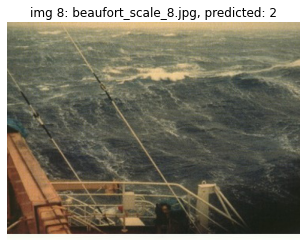

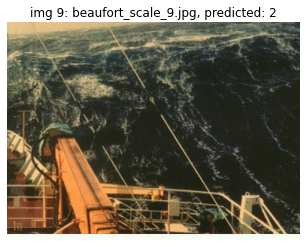

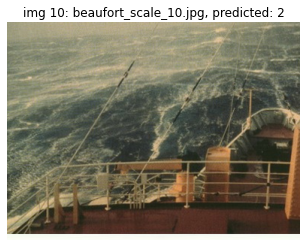

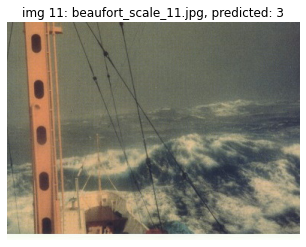

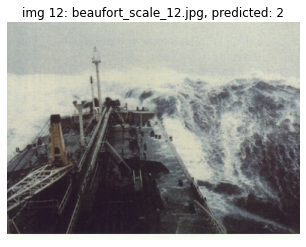

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.50000   0.66667         4
           2    0.33333   0.75000   0.46154         4
           3    0.50000   0.20000   0.28571         5

    accuracy                        0.46154        13
   macro avg    0.61111   0.48333   0.47131        13
weighted avg    0.60256   0.46154   0.45703        13



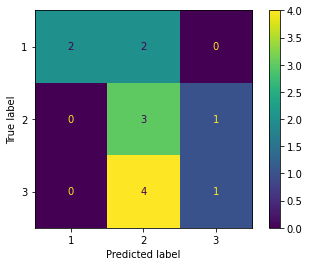

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_untrained_tpn.


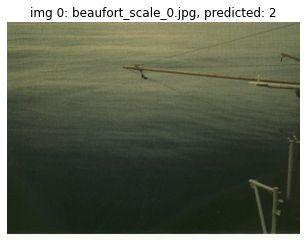

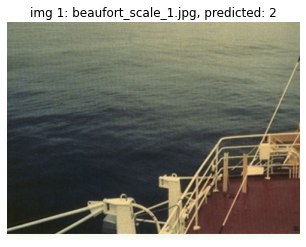

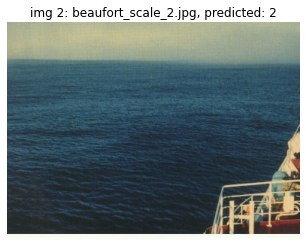

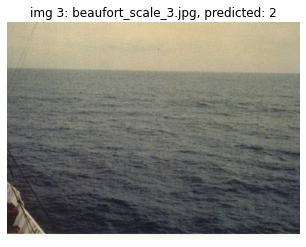

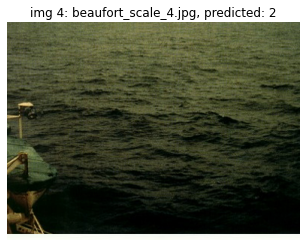

...

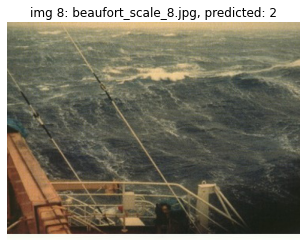

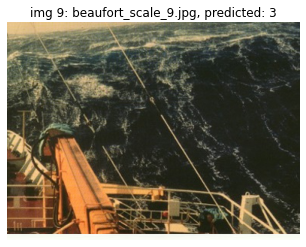

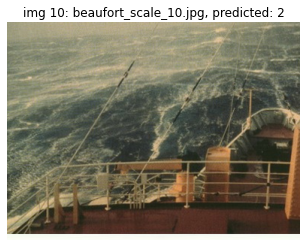

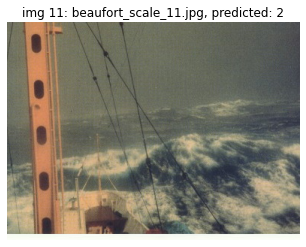

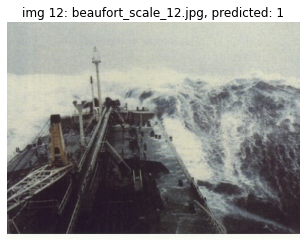

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_untrained_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.36364   1.00000   0.53333         4
           3    1.00000   0.20000   0.33333         5

    accuracy                        0.38462        13
   macro avg    0.45455   0.40000   0.28889        13
weighted avg    0.49650   0.38462   0.29231        13



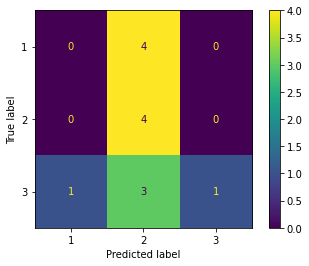

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_tpn.


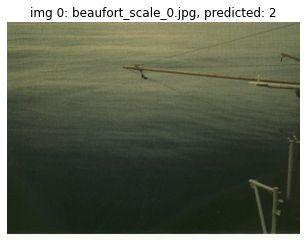

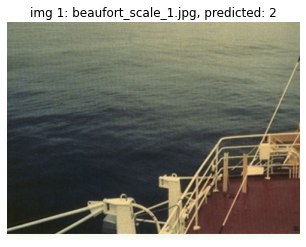

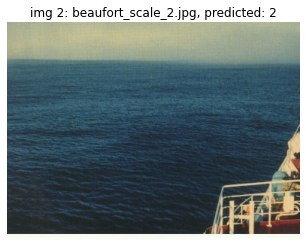

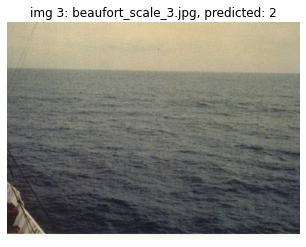

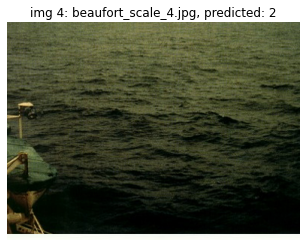

...

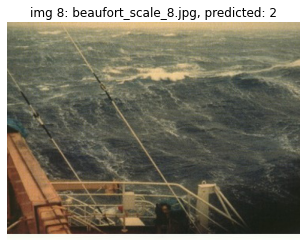

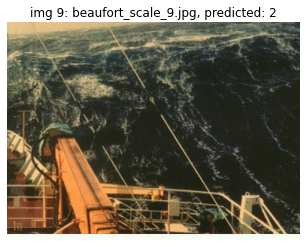

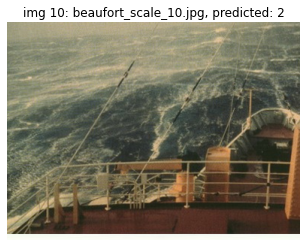

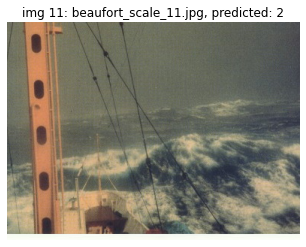

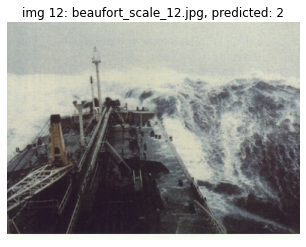

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_weighted_oversample_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.00000   0.00000   0.00000         4
           2    0.30769   1.00000   0.47059         4
           3    0.00000   0.00000   0.00000         5

    accuracy                        0.30769        13
   macro avg    0.10256   0.33333   0.15686        13
weighted avg    0.09467   0.30769   0.14480        13



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


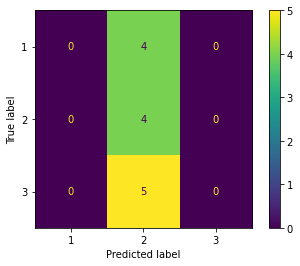

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_loss_tpn.


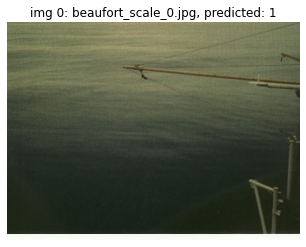

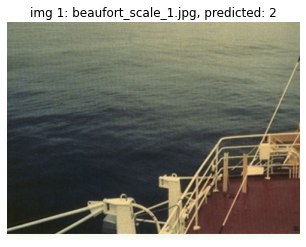

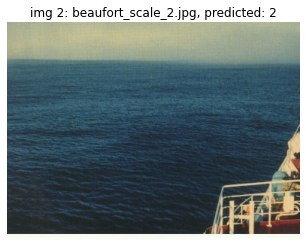

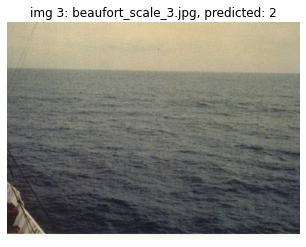

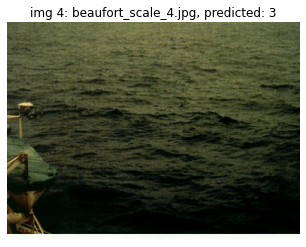

...

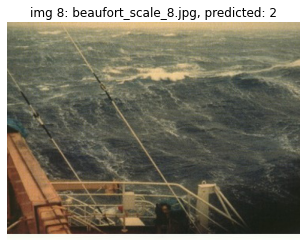

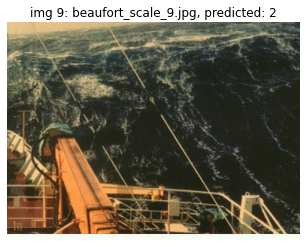

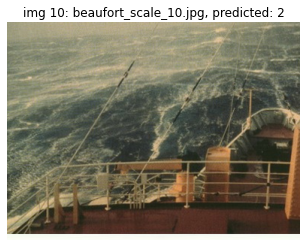

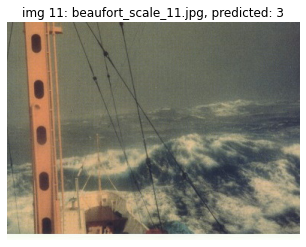

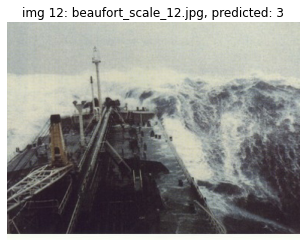

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_weighted_loss_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.25000   0.40000         4
           2    0.14286   0.25000   0.18182         4
           3    0.40000   0.40000   0.40000         5

    accuracy                        0.30769        13
   macro avg    0.51429   0.30000   0.32727        13
weighted avg    0.50549   0.30769   0.33287        13



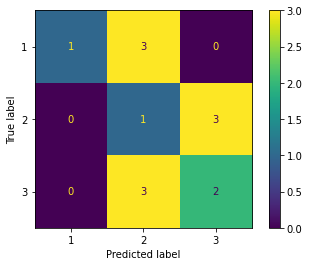

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_weighted_oversample_v2_tpn.


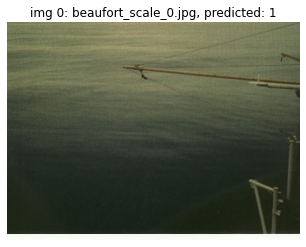

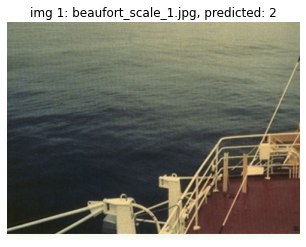

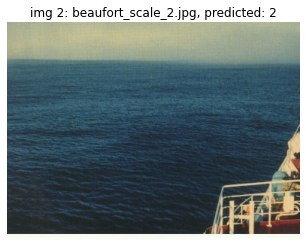

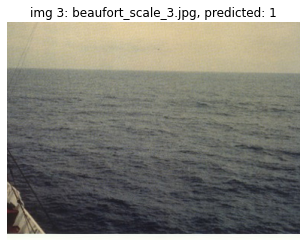

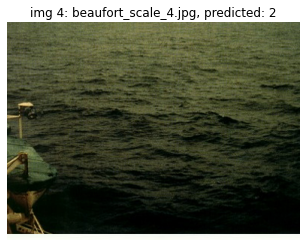

...

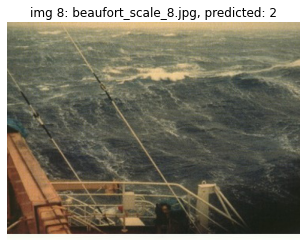

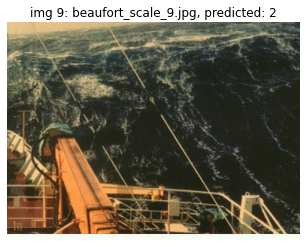

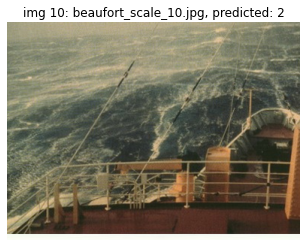

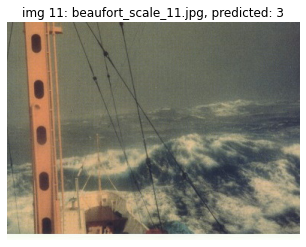

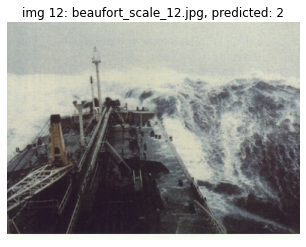

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_weighted_oversample_v2_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.50000   0.66667         4
           2    0.25000   0.50000   0.33333         4
           3    0.33333   0.20000   0.25000         5

    accuracy                        0.38462        13
   macro avg    0.52778   0.40000   0.41667        13
weighted avg    0.51282   0.38462   0.40385        13



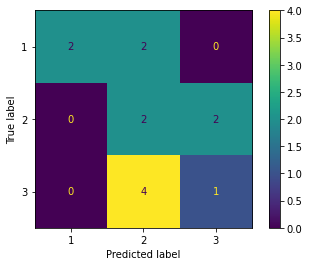

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34_VGG

Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_tpn.


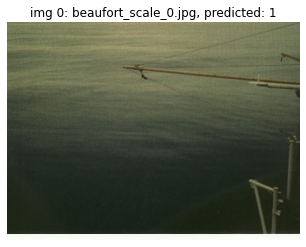

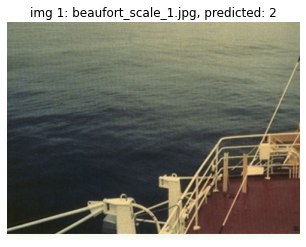

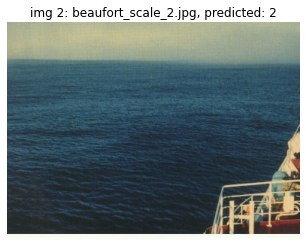

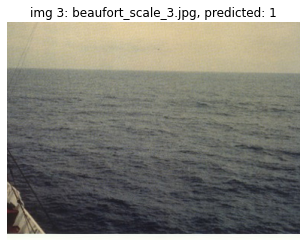

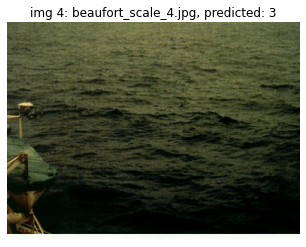

...

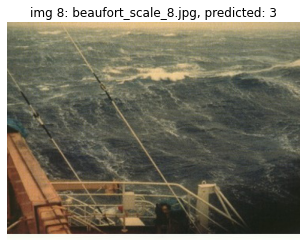

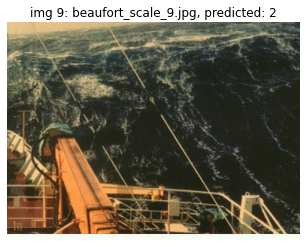

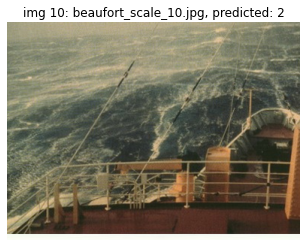

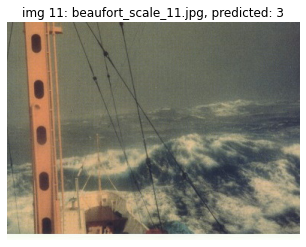

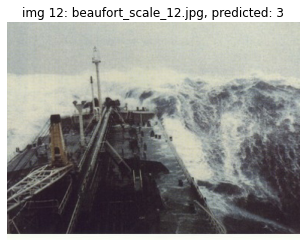

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_vgg_splitted_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.50000   0.66667         4
           2    0.20000   0.25000   0.22222         4
           3    0.50000   0.60000   0.54545         5

    accuracy                        0.46154        13
   macro avg    0.56667   0.45000   0.47811        13
weighted avg    0.56154   0.46154   0.48329        13



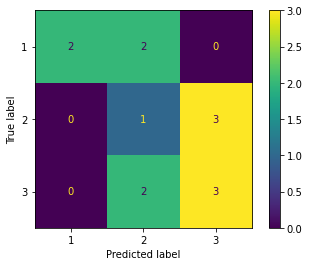

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_oversample_tpn.


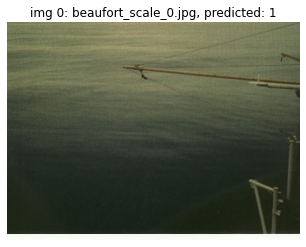

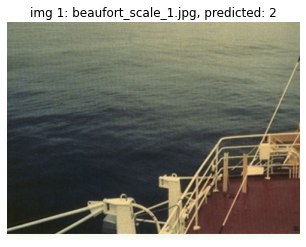

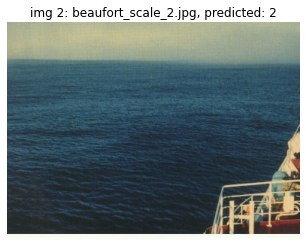

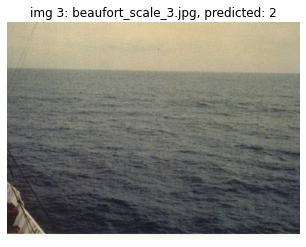

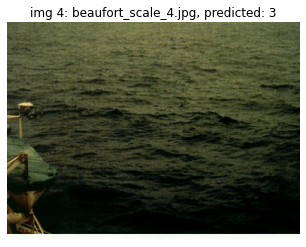

...

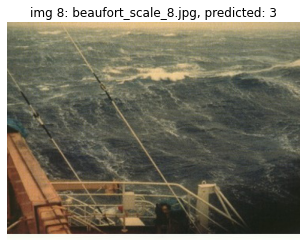

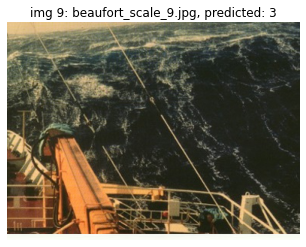

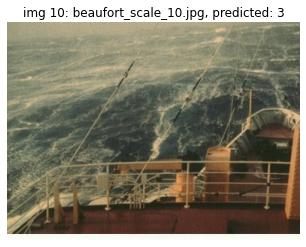

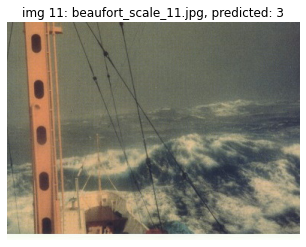

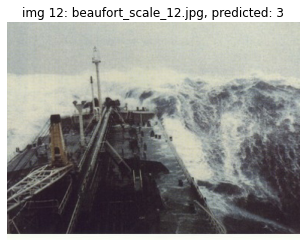

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_vgg_splitted_weighted_oversample_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.25000   0.40000         4
           2    0.25000   0.25000   0.25000         4
           3    0.62500   1.00000   0.76923         5

    accuracy                        0.53846        13
   macro avg    0.62500   0.50000   0.47308        13
weighted avg    0.62500   0.53846   0.49586        13



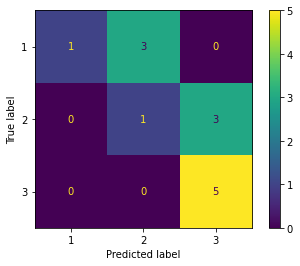

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.
Device: cpu
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.


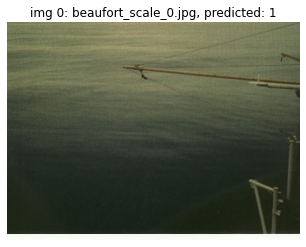

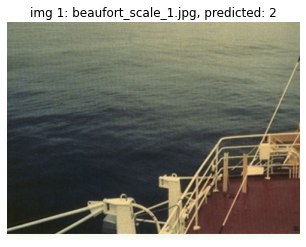

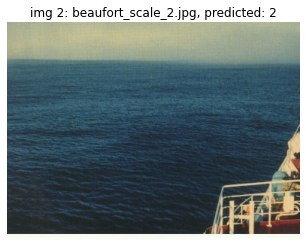

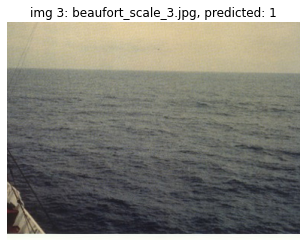

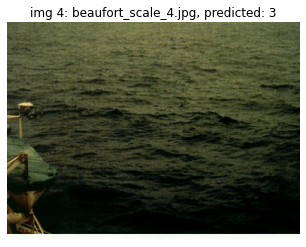

...

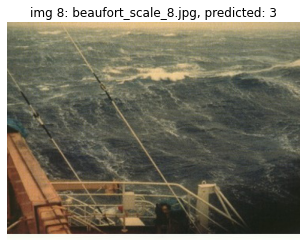

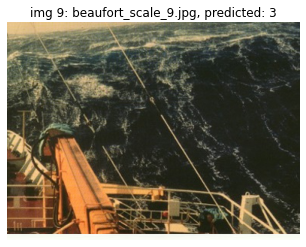

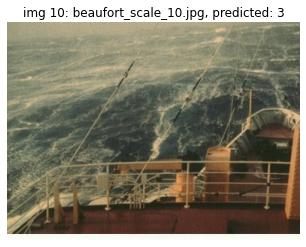

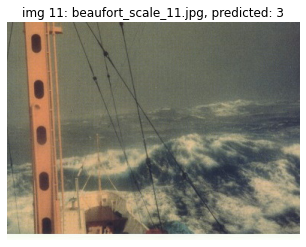

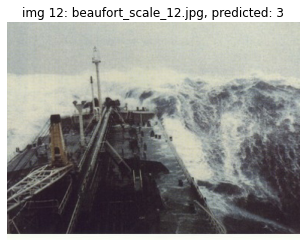

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_vgg_splitted_weighted_loss_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    1.00000   0.50000   0.66667         4
           2    0.33333   0.25000   0.28571         4
           3    0.62500   1.00000   0.76923         5

    accuracy                        0.61538        13
   macro avg    0.65278   0.58333   0.57387        13
weighted avg    0.65064   0.61538   0.58890        13



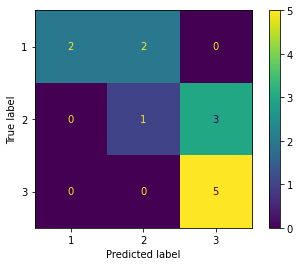

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

### Teste com imagens kaggle

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

def visualize_model(model, dataloaders, class_names, device, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]}, label: {class_names[labels[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

def test_model_kaggle(datasets, model_name):
  # Carrega as imagens pré-processadas de cada dataset
  # base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/resized data/'
  base_dir = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/splitted data/test/'

  y_labels = []
  y_pred = []

  # Definição dos labels para cada dataset
  LABELS = {
        'AA_2014_2014-03-27_09-10-00_12Hz': 1,
        'AA_2015_2015-03-05_10-35-00_12Hz': 1,
        'AA_2015_2015-05-15_09-00-00_12Hz': 1,
        'YS_2017_2017-05-13_05-00-00_10Hz': 1,
        'BS_2011_2011-10-01_16-18-00_15Hz': 0,
        'BS_2011_2011-10-04_11-38-00_12Hz': 0,
        'BS_2011_2011-10-04_13-07-00_12Hz': 0,
        'BS_2011_2011-10-04_15-30-00_12Hz': 0,
        'BS_2013_2013-09-22_13-00-01_10Hz': 0,
        'BS_2013_2013-09-25_12-15-01_12Hz': 0,
        'BS_2013_2013-09-30_10-20-01_12Hz': 0,
        'LJ_2018_2018-01-03_09-39-38_10Hz': 2,
        'kaggle_1': 0,
        'kaggle_2': 0,
        'kaggle_3': 0,
        'kaggle_4': 1
  }

  class_names = [1, 2, 3]

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
            transforms.ToTensor(),  # Transform to tensor
            transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)


  # Definição do modelo
  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### VGG16
  model = models.vgg16_bn(pretrained=True)
  num_features = model.classifier[6].in_features
  features = list(model.classifier.children())[:-1] # Remove last layer
  features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34_VGG
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Sequential(
  #       nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
  #       nn.ReLU(inplace=True),
  #       nn.Dropout(p=0.5, inplace=False),
  #       nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
  #   )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  data = []
  for dataset in tqdm(datasets):
    with open(base_dir + dataset + '.pkl', 'rb') as f:
      record = pickle.load(f)

    print('----------------------')
    print(f'Dataset: {dataset} \n')

    # Normalização e conversão em tensores
    data = [(transform(img), LABELS[dataset]) for img in record]

    del record
    gc.collect()
    
    dataloaders = {'val': torch.utils.data.DataLoader(data, batch_size=4,
                                             shuffle=True, num_workers=4)}


    # Aplicação do teste
    model.eval()
    count = 0

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            y_labels += [int(labels[i]) for i in range(labels.shape[0])]
            y_pred += [int(preds[i]) for i in range(preds.shape[0])]

            for j in range(labels.shape[0]):
              if labels[j] == preds[j]:
                count +=1
            

        print(f'Num de acertos/Num de samples:{count}/{len(data)}')
        print('Acurácia:', count/len(data))

    print('----------------------')
    visualize_model(model, dataloaders, class_names, device, 6)
    del data
    del dataloaders
    gc.collect()

  return y_labels, y_pred

####VGG16

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Model loaded from vgg16_splitted_kaggle_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:1200/1200
Acurácia: 1.0
----------------------


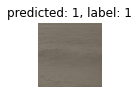

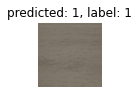

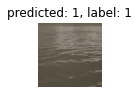

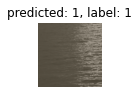

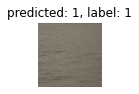

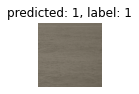

 25%|██▌       | 1/4 [00:21<01:03, 21.07s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:1199/1200
Acurácia: 0.9991666666666666
----------------------


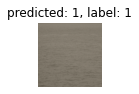

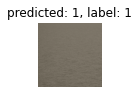

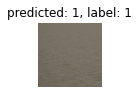

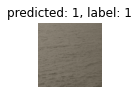

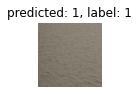

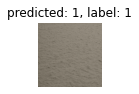

 50%|█████     | 2/4 [00:35<00:34, 17.02s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:1142/1200
Acurácia: 0.9516666666666667
----------------------


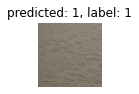

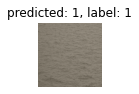

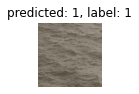

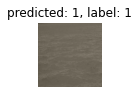

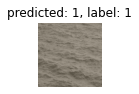

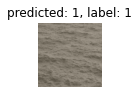

 75%|███████▌  | 3/4 [00:50<00:16, 16.09s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:1099/1200
Acurácia: 0.9158333333333334
----------------------


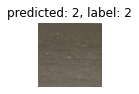

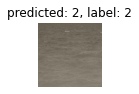

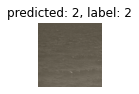

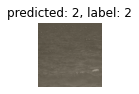

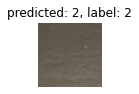

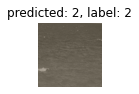

100%|██████████| 4/4 [01:05<00:00, 16.31s/it]


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_kaggle(datasets, 'vgg16_splitted_kaggle_tpn')

              precision    recall  f1-score   support

           1    0.99327   0.98361   0.98842      3600
           2    0.95648   0.91583   0.93572      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.96667      4800
   macro avg    0.64992   0.63315   0.64138      4800
weighted avg    0.98407   0.96667   0.97524      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


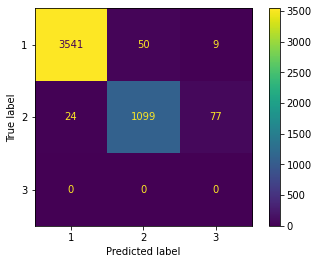

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:347/1200
Acurácia: 0.2891666666666667
----------------------


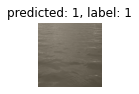

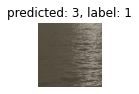

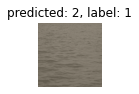

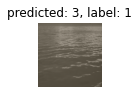

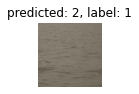

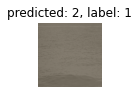

 25%|██▌       | 1/4 [00:08<00:24,  8.01s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:224/1200
Acurácia: 0.18666666666666668
----------------------


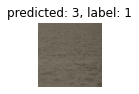

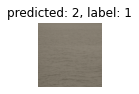

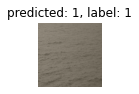

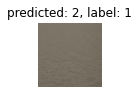

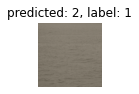

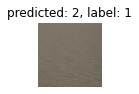

 50%|█████     | 2/4 [00:15<00:15,  7.94s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:70/1200
Acurácia: 0.058333333333333334
----------------------


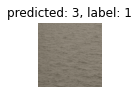

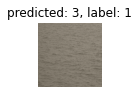

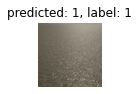

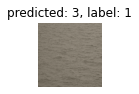

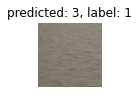

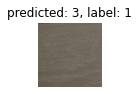

 75%|███████▌  | 3/4 [00:23<00:07,  7.94s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:5/1200
Acurácia: 0.004166666666666667
----------------------


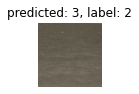

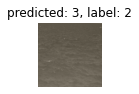

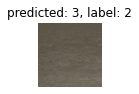

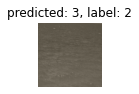

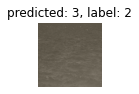

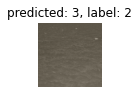

100%|██████████| 4/4 [00:32<00:00,  8.13s/it]


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_kaggle(datasets, 'resnet34_splitted_weighted_oversample_tpn')

              precision    recall  f1-score   support

           1    0.98606   0.31444   0.47683      3600
           2    0.00649   0.00417   0.00507      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.23688      4800
   macro avg    0.33085   0.10620   0.16064      4800
weighted avg    0.74117   0.23688   0.35889      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


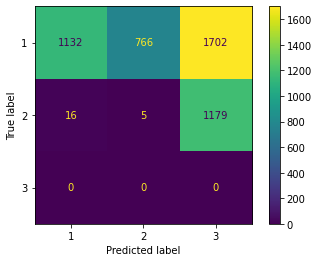

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet152

Device: cuda:0
Model loaded from resnet152_splitted_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:712/1200
Acurácia: 0.5933333333333334
----------------------


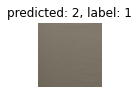

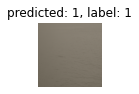

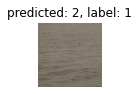

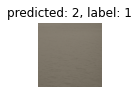

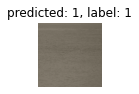

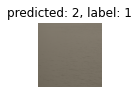

 25%|██▌       | 1/4 [00:15<00:47, 15.80s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:561/1200
Acurácia: 0.4675
----------------------


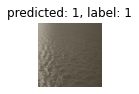

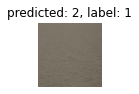

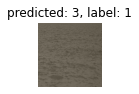

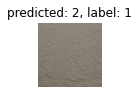

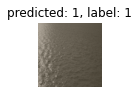

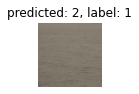

 50%|█████     | 2/4 [00:30<00:30, 15.30s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:938/1200
Acurácia: 0.7816666666666666
----------------------


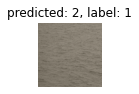

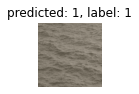

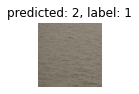

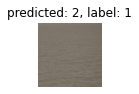

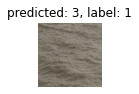

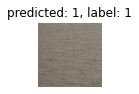

 75%|███████▌  | 3/4 [00:45<00:15, 15.19s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:82/1200
Acurácia: 0.06833333333333333
----------------------


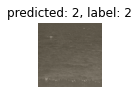

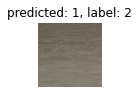

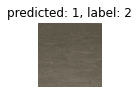

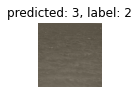

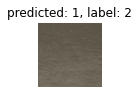

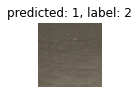

100%|██████████| 4/4 [01:01<00:00, 15.25s/it]


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_kaggle(datasets, 'resnet152_splitted_tpn')

              precision    recall  f1-score   support

           1    0.67388   0.61417   0.64264      3600
           2    0.06101   0.06833   0.06447      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.47771      4800
   macro avg    0.24496   0.22750   0.23570      4800
weighted avg    0.52066   0.47771   0.49810      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


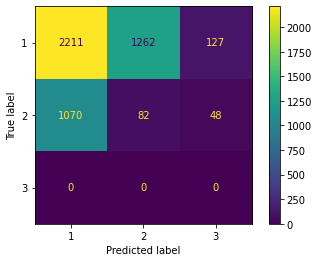

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34_VGG

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_tpn.


  0%|          | 0/4 [00:00<?, ?it/s]

----------------------
Dataset: kaggle_1 



/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Num de acertos/Num de samples:489/1200
Acurácia: 0.4075
----------------------


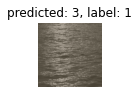

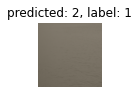

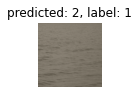

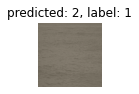

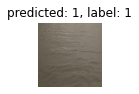

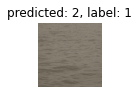

 25%|██▌       | 1/4 [00:08<00:24,  8.31s/it]

----------------------
Dataset: kaggle_2 

Num de acertos/Num de samples:357/1200
Acurácia: 0.2975
----------------------


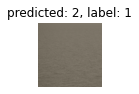

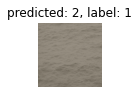

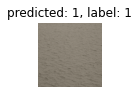

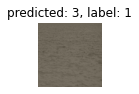

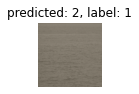

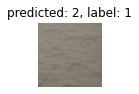

 50%|█████     | 2/4 [00:16<00:16,  8.12s/it]

----------------------
Dataset: kaggle_3 

Num de acertos/Num de samples:81/1200
Acurácia: 0.0675
----------------------


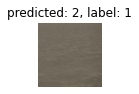

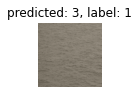

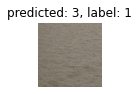

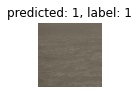

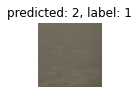

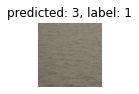

 75%|███████▌  | 3/4 [00:24<00:08,  8.11s/it]

----------------------
Dataset: kaggle_4 

Num de acertos/Num de samples:11/1200
Acurácia: 0.009166666666666667
----------------------


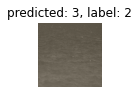

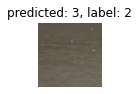

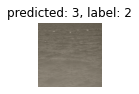

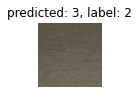

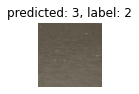

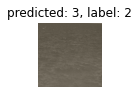

100%|██████████| 4/4 [00:32<00:00,  8.11s/it]


In [ ]:
datasets = [
    'kaggle_1',
    'kaggle_2',
    'kaggle_3',
    'kaggle_4'
  ]

y_labels, y_preds = test_model_kaggle(datasets, 'resnet34_vgg_splitted_weighted_loss_tpn')

              precision    recall  f1-score   support

           1    0.96562   0.25750   0.40658      3600
           2    0.00900   0.00917   0.00908      1200
           3    0.00000   0.00000   0.00000         0

    accuracy                        0.19542      4800
   macro avg    0.32488   0.08889   0.13855      4800
weighted avg    0.72647   0.19542   0.30721      4800



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


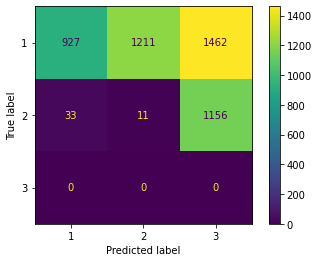

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

### Imagens beaufort + modelos kaggle

In [ ]:
def test_img(img, model_name):
  # Define o device
  device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
  print('Device:', device)

  ### VGG16
  # model = models.vgg16_bn(pretrained=True)
  # num_features = model.classifier[6].in_features
  # features = list(model.classifier.children())[:-1] # Remove last layer
  # features.extend([nn.Linear(num_features, 3)]) # Add our layer with 3 outputs
  # model.classifier = nn.Sequential(*features) # Replace the model classifier

  ### Resnet34
  # model = models.resnet34()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet152
  # model = models.resnet152()
  # num_ftrs = model.fc.in_features
  # model.fc = nn.Linear(num_ftrs, 3)

  ### Resnet34_VGG
  model = models.resnet34()
  num_ftrs = model.fc.in_features
  model.fc = nn.Sequential(
        nn.Linear(in_features=num_ftrs, out_features=num_ftrs, bias=True),
        nn.ReLU(inplace=True),
        nn.Dropout(p=0.5, inplace=False),
        nn.Linear(in_features=num_ftrs, out_features=3, bias=True) # 3 classes
    )

  # Carrega os parâmetros do modelo salvo
  model.load_state_dict(torch.load(f'/content/gdrive/Shareddrives/TCC - S09/Notebooks/models/{model_name}.pth', map_location=lambda storage, loc: storage))
  print('Model loaded from %s.' % f'{model_name}')
  model.to(device)

  dataloaders = {'val': torch.utils.data.DataLoader([img], batch_size=1,
                                             shuffle=True, num_workers=4)}

  # Aplicação do teste
  model.eval()
  count = 0

  with torch.no_grad():
      for i, inputs in enumerate(dataloaders['val']):
          inputs = inputs.to(device)

          outputs = model(inputs)
          _, preds = torch.max(outputs, 1)

          return preds[0]

#### VGG16

Device: cuda:0


/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_BN_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_BN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16_bn-6c64b313.pth" to /root/.cache/torch/hub/checkpoints/vgg16_bn-6c64b313.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

Model loaded from vgg16_splitted_kaggle_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from vgg16_splitted_kaggle_tpn.


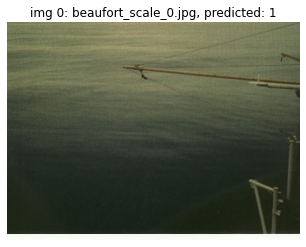

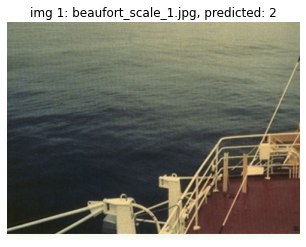

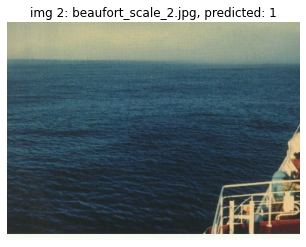

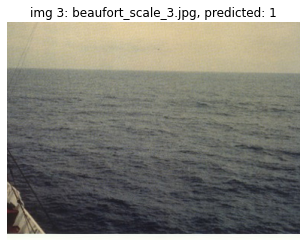

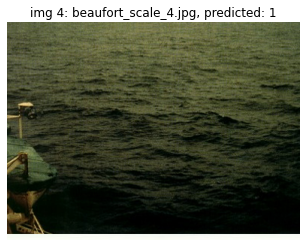

...

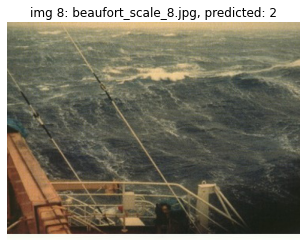

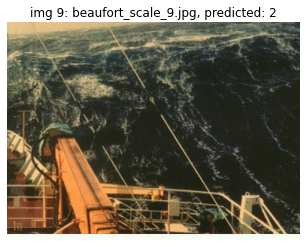

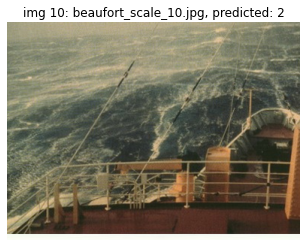

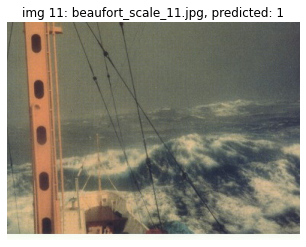

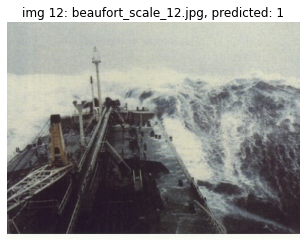

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'vgg16_splitted_kaggle_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.42857   0.75000   0.54545         4
           2    0.33333   0.50000   0.40000         4
           3    0.00000   0.00000   0.00000         5

    accuracy                        0.38462        13
   macro avg    0.25397   0.41667   0.31515        13
weighted avg    0.23443   0.38462   0.29091        13



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


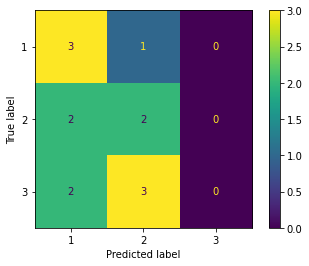

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34

Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_splitted_weighted_oversample_kaggle_tpn.


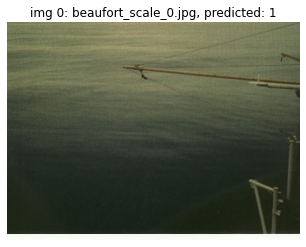

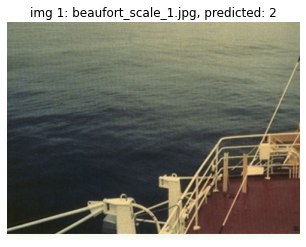

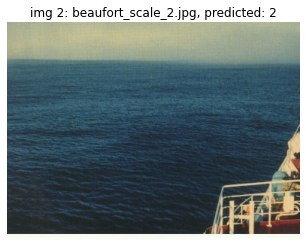

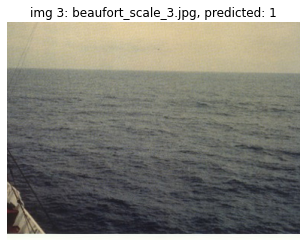

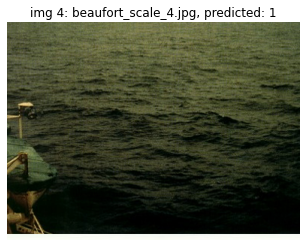

...

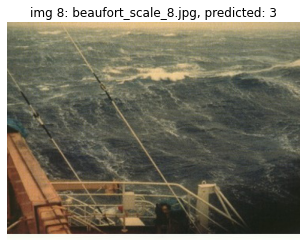

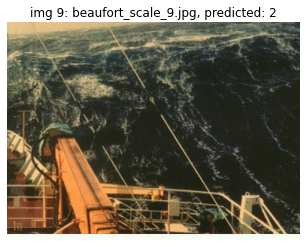

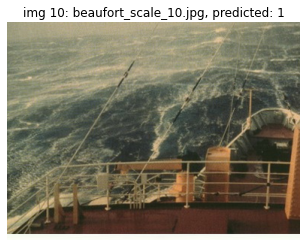

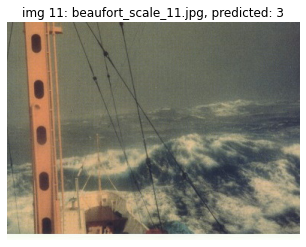

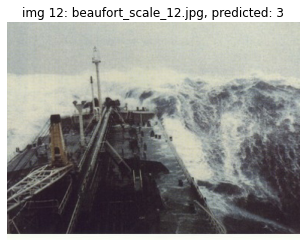

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_splitted_weighted_oversample_kaggle_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.40000   0.50000   0.44444         4
           2    0.40000   0.50000   0.44444         4
           3    1.00000   0.60000   0.75000         5

    accuracy                        0.53846        13
   macro avg    0.60000   0.53333   0.54630        13
weighted avg    0.63077   0.53846   0.56197        13



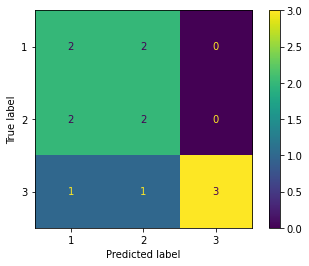

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet152

Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.
Device: cuda:0
Model loaded from resnet152_splitted_kaggle_tpn.


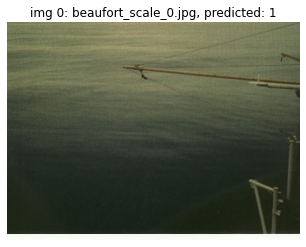

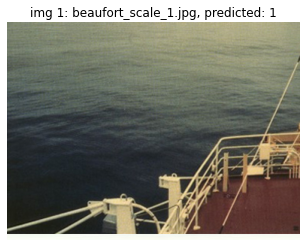

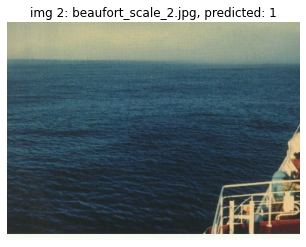

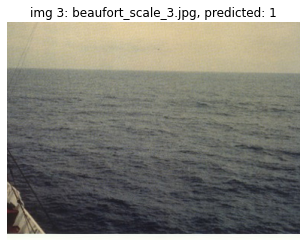

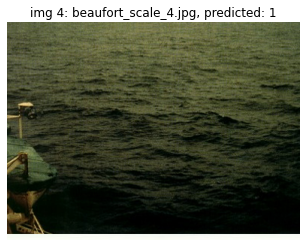

...

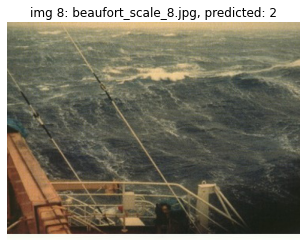

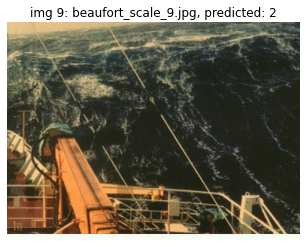

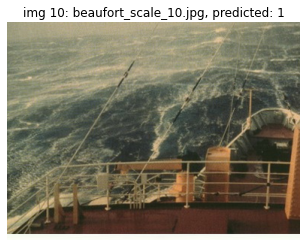

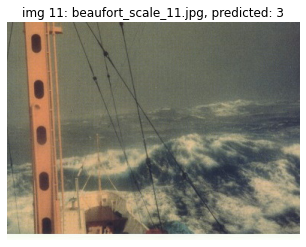

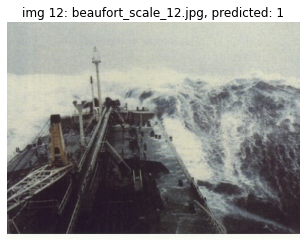

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet152_splitted_kaggle_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.50000   1.00000   0.66667         4
           2    0.33333   0.25000   0.28571         4
           3    0.50000   0.20000   0.28571         5

    accuracy                        0.46154        13
   macro avg    0.44444   0.48333   0.41270        13
weighted avg    0.44872   0.46154   0.40293        13



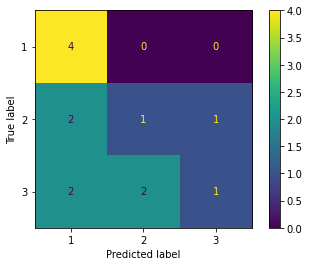

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()

#### Resnet34_VGG

Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.
Device: cuda:0
Model loaded from resnet34_vgg_splitted_weighted_loss_kaggle_tpn.


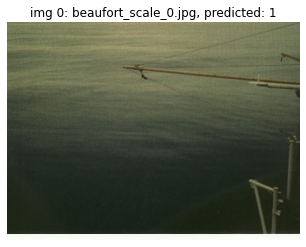

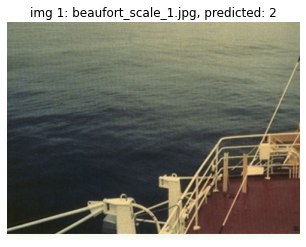

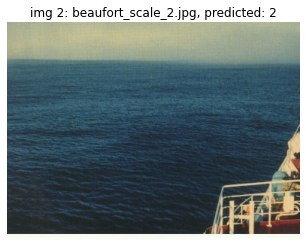

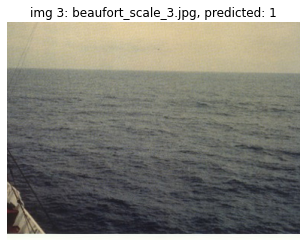

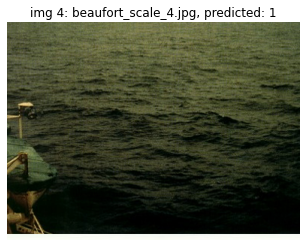

...

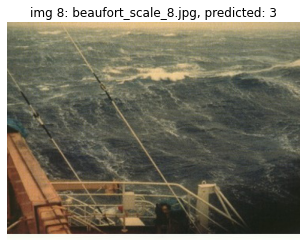

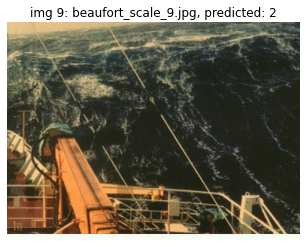

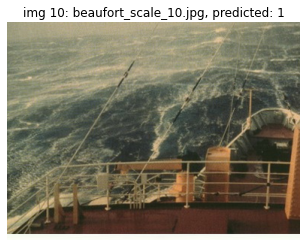

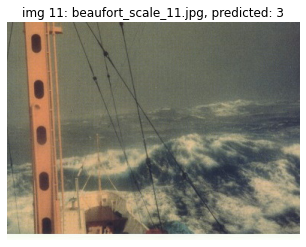

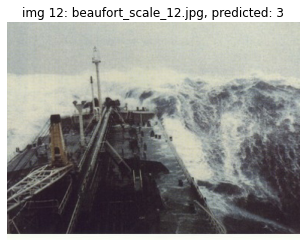

In [ ]:
# Constantes
base_path = '/content/gdrive/Shareddrives/TCC - S09/Notebooks/beaufort tests/'
data = []

class_names = [1, 2, 3]

y_labels = [0,0,0,0,1,1,1,1,2,2,2,2,2]
y_preds = []

for i, image in enumerate(os.listdir(base_path)):
  img = Image.open(base_path + image)
  img = transforms.functional.crop(img, top=0, left=5, width=390, height=290)

  # Transformações a serem aplicadas nas imagens
  transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=3),
    transforms.CenterCrop(224),
    transforms.ToTensor(),  # Transform to tensor
    transforms.Normalize((0.5,), (0.5,))  # Scale images to [-1, 1]
  ])

  img_tensor = transform(img)

  y_hat = test_img(img_tensor, 'resnet34_vgg_splitted_weighted_loss_kaggle_tpn')
  y_preds.append(int(y_hat))

  plt.figure()
  plt.axis('off')
  plt.title(f'img {i}: {image}, predicted: {class_names[y_hat]}')
  plt.imshow(img, cmap='gray')

              precision    recall  f1-score   support

           1    0.33333   0.50000   0.40000         4
           2    0.25000   0.25000   0.25000         4
           3    1.00000   0.60000   0.75000         5

    accuracy                        0.46154        13
   macro avg    0.52778   0.45000   0.46667        13
weighted avg    0.56410   0.46154   0.48846        13



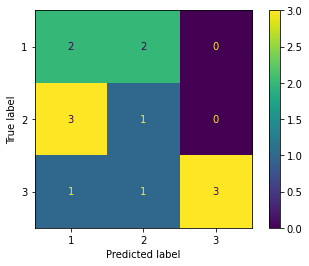

In [ ]:
print(classification_report(y_labels, y_preds, target_names=['1', '2', '3'], digits=5))

conf_matrix = confusion_matrix(y_true=y_labels, y_pred=y_preds)

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                               display_labels=['1', '2', '3'])

disp.plot()